# 4C 21.35

In [24]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d

## Get the spectrum

In [25]:
_ENERGY = np.logspace(2, np.log10(800000), 5000) #MeV
_ENERGY2 = np.logspace(np.log10(0.014), np.log10(0.195), 5000) #MeV
erg2keV = 6.242e+8 

_ENERGY_COSI_DC3 = np.array([1.00000e+02,1.09854e+02,1.20679e+02,1.32571e+02,1.45635e+02,1.59986e+02,
    1.75751e+02,1.93070e+02,2.12095e+02,2.32995e+02,2.55955e+02,2.81177e+02,3.08884e+02,3.39322e+02,
    3.72759e+02,4.09492e+02,4.49843e+02,4.94171e+02,5.42868e+02,5.96362e+02,6.55129e+02,
    7.19686e+02,7.90604e+02,8.68511e+02,9.54095e+02,1.04811e+03,1.15140e+03,1.26486e+03,
    1.38950e+03,1.52642e+03,1.67683e+03,1.84207e+03,2.02359e+03,2.22300e+03,2.44205e+03,
    2.68270e+03,2.94705e+03,3.23746e+03,3.55648e+03,3.90694e+03,4.29193e+03,4.71487e+03,
    5.17947e+03,5.68987e+03,6.25055e+03,6.86649e+03,7.54312e+03,8.28643e+03,9.10298e+03,
    1.00000e+04]) /1000 #MeV


def PL(E, norm, index):
    return norm * E**(-index)
    
def LogParabola(norm, index1, index2, pivot_energy):
    """Returns a spline of a LogParabola spectrum with given parameters
    """
    _ee = _ENERGY = np.logspace(-2, np.log10(800000), 10000)
    _spec = norm*(_ENERGY/pivot_energy)**(-index1-index2*np.log(_ENERGY/pivot_energy))
    _spec_spline = interp1d(_ENERGY, _spec)
    return _spec_spline

norm         = 1.5773076E-10 #/cm2/s/MeV
norm_keV     = norm / 1000 #/cm2/s/keV
print(norm_keV)
# Quiescent state
index1       = 2.2710254
index2       = 0.048976526
# Flaring state
index1_flare = 2.7
index2_flare = 0.048976526
pivot_energy = 1000 # MeV 

def Swif_PL(_fbat, _ibat):
    _kbat = ( _fbat * (2-_ibat))/((0.195)**(2-_ibat) - (0.014)**(2-_ibat)) 
    _spec = _kbat*(_ENERGY2)**(-_ibat)
    _spec_spline = interp1d(_ENERGY2, _spec)
    return _spec_spline
    
FBAT = 24.50e-12 * erg2keV / 1000 #MeV/cm2/s
IBAT = 1.70
IBAT_low = 1.45
IBAT_high = 1.96


LogParabola(norm, index1, index2, pivot_energy)(_ENERGY_COSI_DC3)
LogParabola(norm, index1_flare, index2_flare, pivot_energy)(_ENERGY_COSI_DC3)

1.5773076000000002e-13


array([1.56154702e-01, 1.31821893e-01, 1.11184662e-01, 9.36965746e-02,
       7.88908851e-02, 6.63675827e-02, 5.57839410e-02, 4.68474374e-02,
       3.93086971e-02, 3.29544418e-02, 2.76034551e-02, 2.31013722e-02,
       1.93168921e-02, 1.61383844e-02, 1.34712228e-02, 1.12350867e-02,
       9.36211162e-03, 7.79458432e-03, 6.48389656e-03, 5.38896873e-03,
       4.47503227e-03, 3.71290588e-03, 3.07790769e-03, 2.54929542e-03,
       2.10965041e-03, 1.74431973e-03, 1.44097894e-03, 1.18937992e-03,
       9.80859874e-04, 8.08201320e-04, 6.65361430e-04, 5.47286082e-04,
       4.49778151e-04, 3.69321729e-04, 3.02997044e-04, 2.48366498e-04,
       2.03411388e-04, 1.66447831e-04, 1.36084499e-04, 1.11163269e-04,
       9.07276350e-05, 7.39843988e-05, 6.02791250e-05, 4.90699911e-05,
       3.99109110e-05, 3.24331242e-05, 2.63337570e-05, 2.13628759e-05,
       1.73153249e-05, 1.40225553e-05])

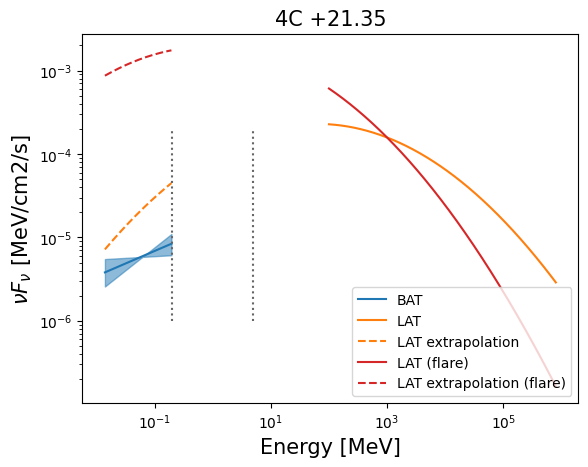

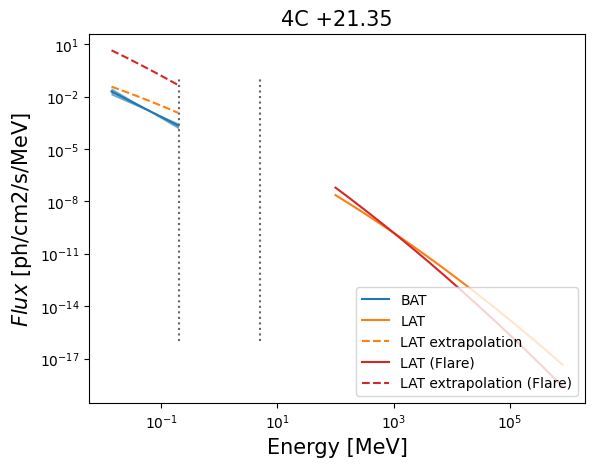

In [26]:
plt.figure()
plt.title('4C +21.35', size=15)
plt.plot(_ENERGY2, _ENERGY2**2 * Swif_PL(FBAT, IBAT)(_ENERGY2), label='BAT')
plt.fill_between(_ENERGY2, _ENERGY2**2 * Swif_PL(FBAT, IBAT_low)(_ENERGY2), 
                 _ENERGY2**2 * Swif_PL(FBAT, IBAT_high)(_ENERGY2), color='tab:blue', alpha=0.5)
plt.plot(_ENERGY, _ENERGY**2 * LogParabola(norm, index1, index2, pivot_energy)(_ENERGY), label='LAT')
plt.plot(_ENERGY2, _ENERGY2**2 * LogParabola(norm, index1, index2, pivot_energy)(_ENERGY2), 
         color='tab:orange', linestyle='--', label='LAT extrapolation')
plt.plot(_ENERGY, _ENERGY**2 * LogParabola(norm, index1_flare, index2_flare, pivot_energy)(_ENERGY), label='LAT (flare)', color='tab:red')
plt.plot(_ENERGY2, _ENERGY2**2 * LogParabola(norm, index1_flare, index2_flare, pivot_energy)(_ENERGY2), 
         color='tab:red', linestyle='--', label='LAT extrapolation (flare)')
plt.vlines(0.2, 1e-6, 2e-4, color='0.4', linestyle=':')
plt.vlines(5, 1e-6, 2e-4, color='0.4', linestyle=':')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Energy [MeV]', size=15)
plt.ylabel(r'$\nu F_\nu$ [MeV/cm2/s]', size=15)
plt.legend(loc=4)
plt.savefig('4C+21.35_ENspec.png', dpi=200)

plt.figure()
plt.title('4C +21.35', size=15)
plt.plot(_ENERGY2, Swif_PL(FBAT, IBAT)(_ENERGY2), label='BAT')
plt.fill_between(_ENERGY2, Swif_PL(FBAT, IBAT_low)(_ENERGY2), 
                 Swif_PL(FBAT, IBAT_high)(_ENERGY2), color='tab:blue', alpha=0.5)
plt.plot(_ENERGY, LogParabola(norm, index1, index2, pivot_energy)(_ENERGY), label='LAT')
plt.plot(_ENERGY2, LogParabola(norm, index1, index2, pivot_energy)(_ENERGY2), 
         color='tab:orange', linestyle='--', label='LAT extrapolation')
plt.plot(_ENERGY, LogParabola(norm, index1_flare, index2_flare, pivot_energy)(_ENERGY), label='LAT (Flare)', color='tab:red')
plt.plot(_ENERGY2, LogParabola(norm, index1_flare, index2_flare, pivot_energy)(_ENERGY2),
            color='tab:red', linestyle='--', label='LAT extrapolation (Flare)')
plt.vlines(0.2, 1e-16, 1e-1, color='0.4', linestyle=':')
plt.vlines(5, 1e-16, 1e-1, color='0.4', linestyle=':')
plt.xscale('log')
plt.yscale('log')
plt.xlabel('Energy [MeV]', size=15)
plt.ylabel(r'$Flux$ [ph/cm2/s/MeV]', size=15)
plt.legend(loc=4)
plt.savefig('4C+21.35_PHspec.png', dpi=200)

## Integral Photon Flux in COSI energy range

Consider the LAT extrapolated spectrum

In [27]:
COSI_emin, COSI_emax = 0.1, 10 #keV
COSI_ENERGY = np.logspace(np.log10(COSI_emin), np.log10(COSI_emax), 500)  #keV
spectrum = LogParabola(norm, index1, index2, pivot_energy)(COSI_ENERGY)
spectrum_flare = LogParabola(norm, index1_flare, index2_flare, pivot_energy)(COSI_ENERGY)

COSI_tot_flux = np.trapz(spectrum, x=COSI_ENERGY)
COSI_tot_flux_flare = np.trapz(spectrum_flare, x=COSI_ENERGY)

print('0.1-10 MeV Flux =', COSI_tot_flux, 'ph/cm2/s')
print('0.1-10 MeV Flux (flare) =', COSI_tot_flux_flare, 'ph/cm2/s')

COSI_ENERGY

0.1-10 MeV Flux = 0.0005535445717202267 ph/cm2/s
0.1-10 MeV Flux (flare) = 0.017293698812562888 ph/cm2/s


array([ 0.1       ,  0.10092715,  0.1018629 ,  0.10280732,  0.1037605 ,
        0.10472252,  0.10569346,  0.10667339,  0.10766242,  0.10866061,
        0.10966806,  0.11068485,  0.11171107,  0.1127468 ,  0.11379213,
        0.11484715,  0.11591196,  0.11698664,  0.11807128,  0.11916598,
        0.12027083,  0.12138593,  0.12251136,  0.12364722,  0.12479362,
        0.12595065,  0.1271184 ,  0.12829698,  0.12948649,  0.13068702,
        0.13189869,  0.13312159,  0.13435583,  0.13560151,  0.13685874,
        0.13812763,  0.13940828,  0.14070081,  0.14200532,  0.14332192,
        0.14465073,  0.14599187,  0.14734543,  0.14871155,  0.15009033,
        0.15148189,  0.15288636,  0.15430385,  0.15573448,  0.15717837,
        0.15863565,  0.16010645,  0.16159088,  0.16308907,  0.16460115,
        0.16612725,  0.1676675 ,  0.16922204,  0.17079098,  0.17237447,
        0.17397264,  0.17558563,  0.17721358,  0.17885662,  0.18051489,
        0.18218853,  0.1838777 ,  0.18558252,  0.18730315,  0.18

# Retrive lightcurve from LCR database

In [28]:
SRC_NAME = '4FGL J1224.9+2122'
max_met = 699235205
min_met = 239587201

In [29]:
print('Reading the LCR database...')

df = pd.read_csv('new_db_Feb2023.csv')

Reading the LCR database...


In [30]:
# We want daily cadence to then study weekly lightcurve in COSI -- Also get the weekly LC to compare
src_lc_d = df[(df['cadence']=='daily')]
src_lc_w = df[(df['cadence']=='weekly')]

src_tmin = src_lc_d[src_lc_d['source_name']==SRC_NAME]['tmin']
src_tmax = src_lc_d[src_lc_d['source_name']==SRC_NAME]['tmax']
src_tmean = (src_tmin + src_tmax) / 2

src_twmin = src_lc_w[src_lc_w['source_name']==SRC_NAME]['tmin']
src_twmax = src_lc_w[src_lc_w['source_name']==SRC_NAME]['tmax']
src_twmean = (src_twmin + src_twmax) / 2

src_flux2 = np.array(src_lc_d[src_lc_d['source_name']==SRC_NAME]['photon_flux2'])
src_fluxerr2 = np.array(src_lc_d[src_lc_d['source_name']==SRC_NAME]['photon_flux_error2'])

src_flux2w = np.array(src_lc_w[src_lc_w['source_name']==SRC_NAME]['photon_flux2'])
src_fluxerr2w = np.array(src_lc_w[src_lc_w['source_name']==SRC_NAME]['photon_flux_error2'])

Mean fluxes (daily, weekly): (3.3e-07, 2.9e-07)


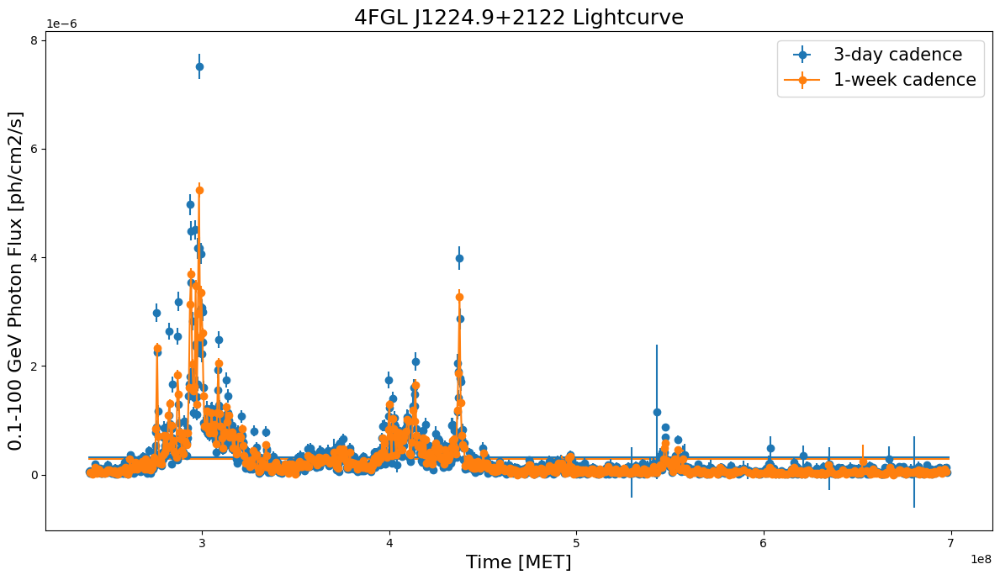

In [31]:
fig, ax = plt.subplots(1, 1, figsize=(12,7), sharex=True)
ax.set_title('%s Lightcurve'%SRC_NAME, size=18)
            
plt.hlines(np.nanmean(src_flux2), min_met, max_met)
plt.hlines(np.nanmean(src_flux2w), min_met, max_met, color='tab:orange')
print('Mean fluxes (daily, weekly): (%.1e, %.1e)'%(np.nanmean(src_flux2), np.nanmean(src_flux2w)))

ax.errorbar(src_tmean, src_flux2, fmt='o',
             xerr=[src_tmean-src_tmin, src_tmax-src_tmean],
             yerr=src_fluxerr2, label='3-day cadence')
ax.errorbar(src_twmean, src_flux2w, fmt='o-',
             xerr=[src_twmean-src_twmin, src_twmax-src_twmean],
             yerr=src_fluxerr2w, label='1-week cadence')

ax.set_xlabel('Time [MET]', size=16)
ax.set_ylabel('0.1-100 GeV Photon Flux [ph/cm2/s]', size=16)
plt.legend(fontsize=15)
plt.tight_layout()
plt.savefig('4C+21.35_LCRlightcurve.png', dpi=200)

# Build COSI lightcurve

The idea is to take the variation in flux wrt the average flux in the 3-day cadence LCR lightcurve and apply those variation to the COSI 0.2-5 MeV flux

In [32]:
rel_flux_variation = (src_flux2 - np.nanmean(src_flux2)) / np.nanmean(src_flux2)
rel2max_flux_variation = src_flux2 / np.nanmean(src_flux2)

# rel_flux_variation[np.isnan(rel_flux_variation)] = 1e-6

In [33]:
COSI_flux_lc = COSI_tot_flux + COSI_tot_flux*rel_flux_variation
COSI_flux_mean = np.nanmean(COSI_flux_lc)
COSI_flux_lc_flare = np.zeros_like(COSI_flux_lc)
COSI_flux_lc_noflare = np.zeros_like(COSI_flux_lc)

COSI_lc_flare_selection = np.where(COSI_flux_lc > COSI_flux_mean*3)[0]
COSI_lc_no_flare_selection = np.where(COSI_flux_lc <= COSI_flux_mean*3)[0]
COSI_flux_lc_flare[COSI_lc_flare_selection] = COSI_flux_lc[COSI_lc_flare_selection]
COSI_flux_lc_noflare[COSI_lc_no_flare_selection] = COSI_flux_lc[COSI_lc_no_flare_selection] #+ COSI_tot_flux_flare


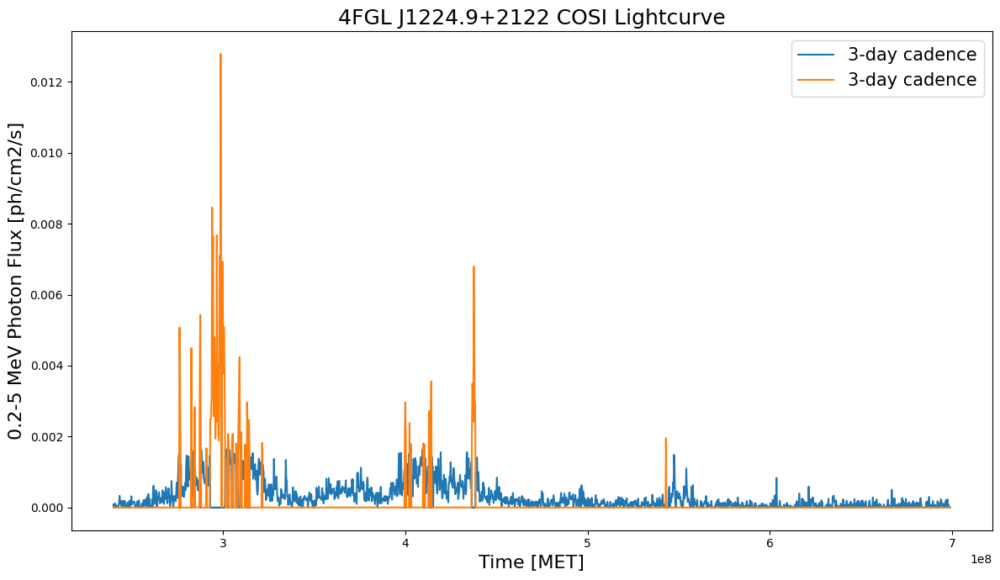

In [34]:
fig, ax = plt.subplots(1, 1, figsize=(12,7), sharex=True)
ax.set_title('%s COSI Lightcurve'%SRC_NAME, size=18)
            
# plt.hlines(COSI_tot_flux, min_met, max_met, color='tab:blue')
# plt.hlines(COSI_tot_flux_flare, min_met, max_met, color='tab:orange')

ax.errorbar(src_tmean, COSI_flux_lc_noflare, fmt='-',
             xerr=[src_tmean-src_tmin, src_tmax-src_tmean],
            label='3-day cadence')
ax.errorbar(src_tmean, COSI_flux_lc_flare, fmt='-',
            label='3-day cadence')

ax.set_xlabel('Time [MET]', size=16)
ax.set_ylabel('0.2-5 MeV Photon Flux [ph/cm2/s]', size=16)
plt.legend(fontsize=15)
plt.tight_layout()
plt.savefig('4C+21.35_COSIlightcurve_DC3.png', dpi=200)

Given those integral fluxes in the COSI range, we compute the PL normalization assuming a spectral index of -1.6

In [35]:
# This is the simple case in which the spectral index is the same in quiescent and flaring state
index_COSI_noflare = 1.6
index_COSI_flare = 2.5
kCOSI_noflare_ = ( COSI_flux_lc_noflare * (2-index_COSI_noflare))/((COSI_emax)**(2-index_COSI_noflare) - (COSI_emin)**(2-index_COSI_noflare))
kCOSI_flare_ = ( COSI_flux_lc_flare * (2-index_COSI_flare))/((COSI_emax)**(2-index_COSI_flare) - (COSI_emin)**(2-index_COSI_flare))
iCOSI_noflare = np.full(len(kCOSI_noflare_), index_COSI_noflare)
iCOSI_flare = np.full(len(kCOSI_flare_), index_COSI_flare)

# if we want to complicate things: have a harder spectrum when flux is > x3 the average flux
# kCOSI_ = []
# iCOSI_ = []
# for f in COSI_flux_lc:
#     if f > 3 * COSI_tot_flux:
#         kCOSI = ( f * (2-1.3))/((COSI_emax)**(2-1.3) - (COSI_emin)**(2-1.3))
#         iCOSI_.append(1.3)
#     else:
#         kCOSI = ( f * (2-index_COSI))/((COSI_emax)**(2-index_COSI) - (COSI_emin)**(2-index_COSI))
#         iCOSI_.append(index_COSI)
#     kCOSI_.append(kCOSI)
# kCOSI_ = np.array(kCOSI_)
# iCOSI_ = np.array(iCOSI_)

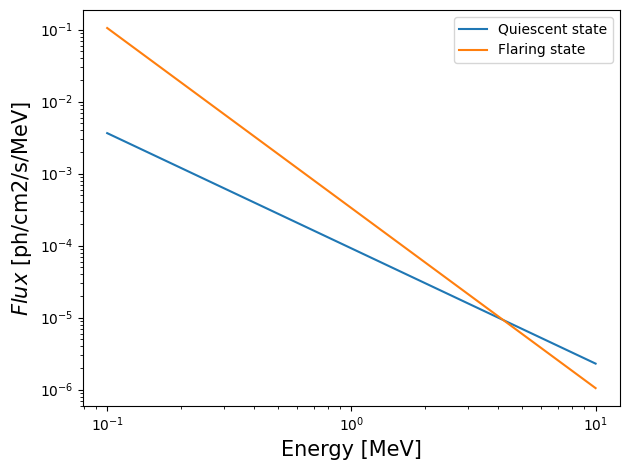

In [36]:
# Check a couple of spectra
plt.figure()
plt.plot(COSI_ENERGY, PL(COSI_ENERGY, kCOSI_noflare_[800], iCOSI_noflare[800]), label='Quiescent state')
plt.plot(COSI_ENERGY, PL(COSI_ENERGY, kCOSI_flare_[223], iCOSI_flare[223]), label='Flaring state' )

plt.xscale('log')
plt.yscale('log')
plt.xlabel('Energy [MeV]', size=15)
plt.ylabel(r'$Flux$ [ph/cm2/s/MeV]', size=15)
plt.legend()
plt.tight_layout()
plt.savefig('4C+21.35_COSIspectra_DC3.png', dpi=200)

In [37]:
for i, e in enumerate(COSI_ENERGY):
        print('DP %.3f %.3e'%(e, PL(e, kCOSI_noflare_[800], iCOSI_noflare[800])))

DP 0.100 3.642e-03
DP 0.101 3.589e-03
DP 0.102 3.536e-03
DP 0.103 3.485e-03
DP 0.104 3.433e-03
DP 0.105 3.383e-03
DP 0.106 3.334e-03
DP 0.107 3.285e-03
DP 0.108 3.237e-03
DP 0.109 3.189e-03
DP 0.110 3.142e-03
DP 0.111 3.096e-03
DP 0.112 3.051e-03
DP 0.113 3.006e-03
DP 0.114 2.962e-03
DP 0.115 2.919e-03
DP 0.116 2.876e-03
DP 0.117 2.834e-03
DP 0.118 2.792e-03
DP 0.119 2.751e-03
DP 0.120 2.711e-03
DP 0.121 2.671e-03
DP 0.123 2.632e-03
DP 0.124 2.594e-03
DP 0.125 2.555e-03
DP 0.126 2.518e-03
DP 0.127 2.481e-03
DP 0.128 2.445e-03
DP 0.129 2.409e-03
DP 0.131 2.374e-03
DP 0.132 2.339e-03
DP 0.133 2.305e-03
DP 0.134 2.271e-03
DP 0.136 2.237e-03
DP 0.137 2.205e-03
DP 0.138 2.172e-03
DP 0.139 2.141e-03
DP 0.141 2.109e-03
DP 0.142 2.078e-03
DP 0.143 2.048e-03
DP 0.145 2.018e-03
DP 0.146 1.988e-03
DP 0.147 1.959e-03
DP 0.149 1.930e-03
DP 0.150 1.902e-03
DP 0.151 1.874e-03
DP 0.153 1.847e-03
DP 0.154 1.820e-03
DP 0.156 1.793e-03
DP 0.157 1.767e-03
DP 0.159 1.741e-03
DP 0.160 1.715e-03
DP 0.162 1.6

In [38]:
for i, e in enumerate(COSI_ENERGY):
        print('DP %.3f %.3e'%(e, PL(e, kCOSI_flare_[223], iCOSI_flare[223])))

DP 0.100 1.050e-01
DP 0.101 1.026e-01
DP 0.102 1.002e-01
DP 0.103 9.796e-02
DP 0.104 9.573e-02
DP 0.105 9.354e-02
DP 0.106 9.141e-02
DP 0.107 8.933e-02
DP 0.108 8.729e-02
DP 0.109 8.530e-02
DP 0.110 8.335e-02
DP 0.111 8.145e-02
DP 0.112 7.959e-02
DP 0.113 7.778e-02
DP 0.114 7.600e-02
DP 0.115 7.427e-02
DP 0.116 7.258e-02
DP 0.117 7.092e-02
DP 0.118 6.930e-02
DP 0.119 6.772e-02
DP 0.120 6.618e-02
DP 0.121 6.467e-02
DP 0.123 6.319e-02
DP 0.124 6.175e-02
DP 0.125 6.034e-02
DP 0.126 5.897e-02
DP 0.127 5.762e-02
DP 0.128 5.631e-02
DP 0.129 5.502e-02
DP 0.131 5.377e-02
DP 0.132 5.254e-02
DP 0.133 5.134e-02
DP 0.134 5.017e-02
DP 0.136 4.903e-02
DP 0.137 4.791e-02
DP 0.138 4.682e-02
DP 0.139 4.575e-02
DP 0.141 4.471e-02
DP 0.142 4.369e-02
DP 0.143 4.269e-02
DP 0.145 4.172e-02
DP 0.146 4.077e-02
DP 0.147 3.984e-02
DP 0.149 3.893e-02
DP 0.150 3.804e-02
DP 0.151 3.717e-02
DP 0.153 3.632e-02
DP 0.154 3.550e-02
DP 0.156 3.469e-02
DP 0.157 3.389e-02
DP 0.159 3.312e-02
DP 0.160 3.237e-02
DP 0.162 3.1

Now, we want to simulate COSI observation of this source and build the observed lightcurve. So I'm going to generate a csv file with time, and PL parameters for each time bin.

/var/folders/c_/m9xq6z1d7ng4l884vymz4c240000gq/T/ipykernel_33380/4150772976.py:27: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2_flare.loc[:,'time[MET]'] = df_flare['time[MET]'] - np.amin(df_flare['time[MET]'])
/var/folders/c_/m9xq6z1d7ng4l884vymz4c240000gq/T/ipykernel_33380/4150772976.py:28: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df2_noflare.loc[:,'time[MET]'] = df_noflare['time[MET]'] - np.amin(df_noflare['time[MET]'])


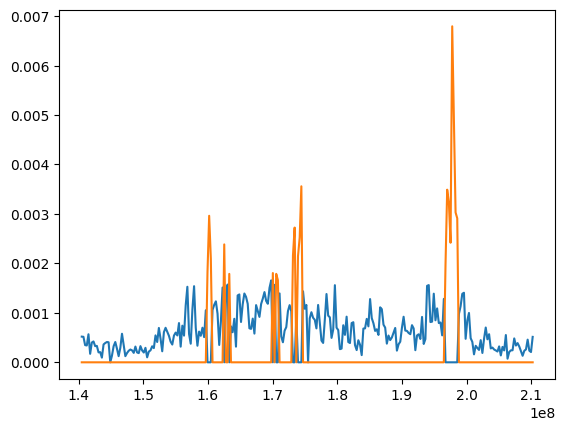

In [39]:
COSI_lc_max = np.amax(np.concatenate((COSI_flux_lc_noflare, COSI_flux_lc_flare)))

# Make the flux ten times higher
db_dict_noflare = {'time[MET]'                     : src_tmin,
           'Flux_100keV5000keV[ph/cm2/s]'  : COSI_flux_lc_noflare,
           'Rel_amplitude'                 : COSI_flux_lc_noflare / COSI_lc_max,
           'PL_norm[ph/cm2/s/MeV]'         : kCOSI_noflare_,
           'Pivot_Energy[MeV]'             : np.full(len(kCOSI_noflare_), 1.),
           'PL_index'                      : iCOSI_noflare
          }
        
db_dict_flare = {'time[MET]'                     : src_tmin,
           'Flux_100keV5000keV[ph/cm2/s]'  : COSI_flux_lc_flare,
           'Rel_amplitude'                 : COSI_flux_lc_flare / COSI_lc_max,
           'PL_norm[ph/cm2/s/MeV]'         : kCOSI_flare_,
           'Pivot_Energy[MeV]'             : np.full(len(kCOSI_flare_), 1.),
           'PL_index'                      : iCOSI_flare
          } 

df_noflare = pd.DataFrame.from_dict(db_dict_noflare)
df_flare = pd.DataFrame.from_dict(db_dict_flare)


df2_flare = df_flare[(df_flare['time[MET]']>3.8e8)&(df_flare['time[MET]']<(4.5e8))]
df2_noflare = df_noflare[(df_noflare['time[MET]']>3.8e8)&(df_noflare['time[MET]']<(4.5e8))] #df2_noflare = df_noflare[(df_noflare['time[MET]']>3.1e8)&(df_noflare['time[MET]']<(3e8+2.552e7))]

df2_flare.loc[:,'time[MET]'] = df_flare['time[MET]'] - np.amin(df_flare['time[MET]'])
df2_noflare.loc[:,'time[MET]'] = df_noflare['time[MET]'] - np.amin(df_noflare['time[MET]'])

plt.figure()
plt.plot(df2_noflare['time[MET]'], df2_noflare['Flux_100keV5000keV[ph/cm2/s]'], label='Quiescent state')
plt.plot(df2_flare['time[MET]'], df2_flare['Flux_100keV5000keV[ph/cm2/s]'], label='Flaring state')

[1835487300 1835487315 1835487330 ... 1843467225 1843467240 1843467255]


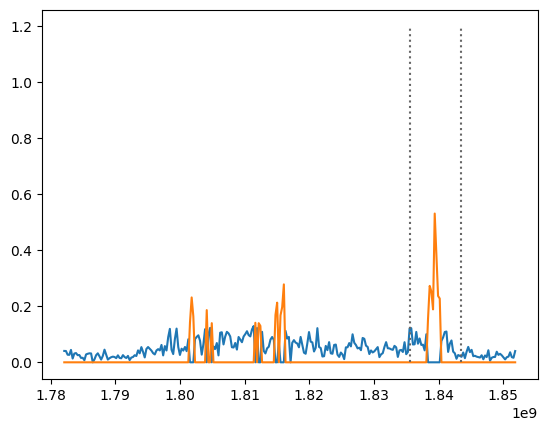

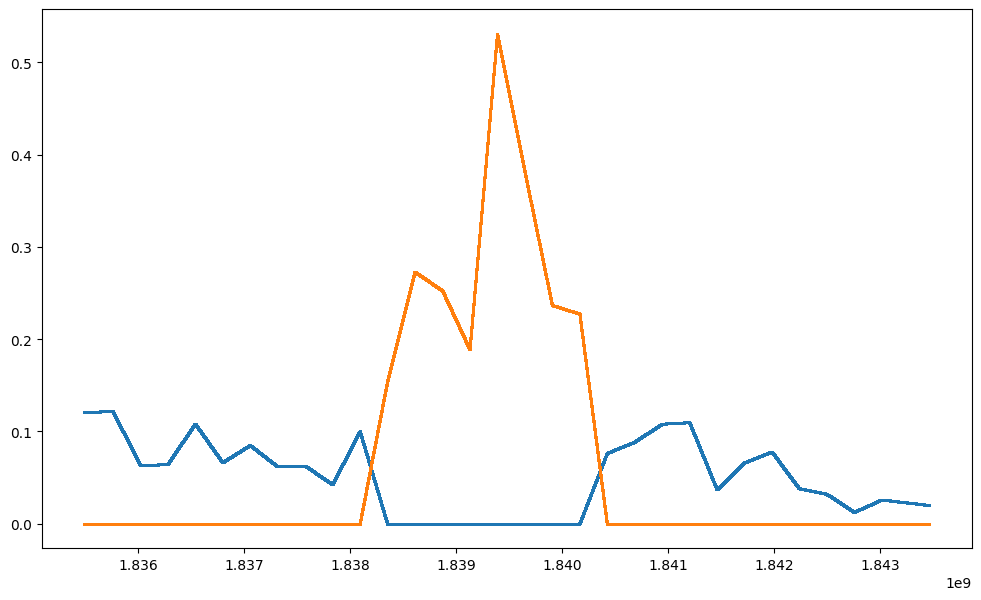

In [59]:
#save dataframe in csv file
df_noflare.to_csv('4C+2135_lighcurve_noflare.csv', index=False) 
df_flare.to_csv('4C+2135_lighcurve_flare.csv', index=False)
time0 = df2_noflare['time[MET]'].to_numpy()[0]
ff = 1.38
plt.figure()
plt.plot(df2_noflare['time[MET]']+(1835487300.0-time0*ff), df2_noflare['Rel_amplitude'], label='Quiescent state')
plt.plot(df2_flare['time[MET]']+(1835487300.0-time0*ff), df2_flare['Rel_amplitude'], label='Flaring state')
plt.vlines(1835487300.0, 0, 1.2, color='0.4', linestyle=':')
plt.vlines(1843467255.0, 0, 1.2, color='0.4', linestyle=':')

mo3noflare_select = (df2_noflare['time[MET]'].to_numpy()+(1835487300.0-time0*ff)> 1835487300.0) & (df2_noflare['time[MET]'].to_numpy()+(1835487300.0-time0*ff) < 1843467255.0)
mo3flare_select = (df2_flare['time[MET]'].to_numpy()+(1835487300.0-time0*ff)> 1835487300.0) & (df2_flare['time[MET]'].to_numpy()+(1835487300.0-time0*ff) < 1843467255.0)

time_select = (df2_noflare['time[MET]'].to_numpy()+(1835487300.0-time0*ff))[mo3noflare_select]
mo3noflare_lc = df2_noflare['Rel_amplitude'].to_numpy()[mo3noflare_select]
mo3flare_lc = df2_flare['Rel_amplitude'].to_numpy()[mo3flare_select]

#create a spline of LC(time) with _initial = 1835487300.0 and t_final = 1843467255.0, with 15 second
time_15sec = np.arange(1835487300, 1843467260)[::15]
mo3noflare_spline = interp1d(time_select, mo3noflare_lc, fill_value='extrapolate')#, kind='cubic')
mo3flare_spline = interp1d(time_select, mo3flare_lc, fill_value='extrapolate')#, kind='cubic')


print(time_15sec)
plt.figure(figsize=(12,7))
# plt.plot((df2_noflare['time[MET]'].to_numpy()+(1835487300.0-time0*ff))[mo3noflare_select], df2_noflare['Rel_amplitude'].to_numpy()[mo3noflare_select], label='Quiescent state')
# plt.plot((df2_flare['time[MET]'].to_numpy()+(1835487300.0-time0*ff))[mo3flare_select], df2_flare['Rel_amplitude'].to_numpy()[mo3flare_select], label='Flaring state')
plt.plot(time_15sec, mo3noflare_spline(time_15sec),'.', markersize='2', label='Quiescent state spline')
plt.plot(time_15sec, mo3flare_spline(time_15sec), '.', markersize='2', label='Flaring state spline')

In [60]:
offset = 1835487300
for i, t in enumerate(time_15sec):
        t0 = np.amin(time_15sec)
        # print('DP %i %.1e'%(t-t0+offset, df2_noflare['Rel_amplitude'].to_numpy()[mo3noflare_select][i]))
        print('DP %i %.5e'%(t-t0+offset, mo3noflare_spline(t)))


DP 1835487300 1.20858e-01
DP 1835487315 1.20858e-01
DP 1835487330 1.20858e-01
DP 1835487345 1.20858e-01
DP 1835487360 1.20858e-01
DP 1835487375 1.20858e-01
DP 1835487390 1.20858e-01
DP 1835487405 1.20858e-01
DP 1835487420 1.20858e-01
DP 1835487435 1.20858e-01
DP 1835487450 1.20858e-01
DP 1835487465 1.20858e-01
DP 1835487480 1.20858e-01
DP 1835487495 1.20858e-01
DP 1835487510 1.20858e-01
DP 1835487525 1.20859e-01
DP 1835487540 1.20859e-01
DP 1835487555 1.20859e-01
DP 1835487570 1.20859e-01
DP 1835487585 1.20859e-01
DP 1835487600 1.20859e-01
DP 1835487615 1.20859e-01
DP 1835487630 1.20859e-01
DP 1835487645 1.20859e-01
DP 1835487660 1.20859e-01
DP 1835487675 1.20859e-01
DP 1835487690 1.20859e-01
DP 1835487705 1.20859e-01
DP 1835487720 1.20859e-01
DP 1835487735 1.20860e-01
DP 1835487750 1.20860e-01
DP 1835487765 1.20860e-01
DP 1835487780 1.20860e-01
DP 1835487795 1.20860e-01
DP 1835487810 1.20860e-01
DP 1835487825 1.20860e-01
DP 1835487840 1.20860e-01
DP 1835487855 1.20860e-01
DP 183548787

In [61]:
offset = 1835487300
for i, t in enumerate(time_15sec):
        t0 = np.amin(time_15sec)
        print('DP %i %.3e'%(t-t0+offset, mo3flare_spline(t)))

DP 1835487300 0.000e+00
DP 1835487315 0.000e+00
DP 1835487330 0.000e+00
DP 1835487345 0.000e+00
DP 1835487360 0.000e+00
DP 1835487375 0.000e+00
DP 1835487390 0.000e+00
DP 1835487405 0.000e+00
DP 1835487420 0.000e+00
DP 1835487435 0.000e+00
DP 1835487450 0.000e+00
DP 1835487465 0.000e+00
DP 1835487480 0.000e+00
DP 1835487495 0.000e+00
DP 1835487510 0.000e+00
DP 1835487525 0.000e+00
DP 1835487540 0.000e+00
DP 1835487555 0.000e+00
DP 1835487570 0.000e+00
DP 1835487585 0.000e+00
DP 1835487600 0.000e+00
DP 1835487615 0.000e+00
DP 1835487630 0.000e+00
DP 1835487645 0.000e+00
DP 1835487660 0.000e+00
DP 1835487675 0.000e+00
DP 1835487690 0.000e+00
DP 1835487705 0.000e+00
DP 1835487720 0.000e+00
DP 1835487735 0.000e+00
DP 1835487750 0.000e+00
DP 1835487765 0.000e+00
DP 1835487780 0.000e+00
DP 1835487795 0.000e+00
DP 1835487810 0.000e+00
DP 1835487825 0.000e+00
DP 1835487840 0.000e+00
DP 1835487855 0.000e+00
DP 1835487870 0.000e+00
DP 1835487885 0.000e+00
DP 1835487900 0.000e+00
DP 1835487915 0.